# Dataset Creation

In [2]:
import pandas as pd
import numpy as np
import random
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')




# graph settings : 
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [3]:
def randomNumber(x):
    return random.randint(0,x)
def randomDate(x):
    return random.randint(5,x)
def randomYear(x):
    return random.randint(1,x)
def randomColor():
    r = lambda: random.randint(0,255)
    return ('#%02X%02X%02X' % (r(),r(),r()))
def randomDateCust():
    return random.randint(1,2)


In [4]:
# for ground owners
#(date-pk,year(not required),day, month, week number , groundName, timeslot chosen , sport chosen ) --> cost spent

years = ['2010','2011','2012','2013','2014','2015','2016','2017','2018','2019','2020','2021']

days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

groundNames = ['Ground1','Ground2','Ground3','Ground4']

timeslots = ['timeslot1','timeslot2','timeslot3','timeslot4','timeslot5','timeslot6','timeslot7']

months = ['January','February','March','April','May','June','July','August','September','October','November','December']

sports = ['sport1','sport2','sport3','sport4','sport5','sport6']

#for ground 1 : 
g1_prices = {'sport1':100,'sport2':150,'sport3':250,'sport4':350,'sport5':400,'sport6':200}
g2_prices = {'sport1':200,'sport2':150,'sport3':450,'sport4':250,'sport5':200,'sport6':100}
g3_prices = {'sport1':350,'sport2':450,'sport3':150,'sport4':200,'sport5':300,'sport6':250}
g4_prices = {'sport1':450,'sport2':250,'sport3':150,'sport4':100,'sport5':250,'sport6':500}


data = [] 
data2=[]
# assuming on an average,30 people and minimum 5 people visit the ground everyday 
for i in range(1,3000):  
    num_dates = randomDate(30)
    tot_cost=0
    tYear =""
    tDay=""
    tGroundName=""
    tTimeSlot=""
    tMonth =""
    tSport=""
    tDate = i
    tot_cust = num_dates
    day_cost = []
    
    for j in range(1,tot_cust):    
        tDay = days[randomNumber(len(days)-1)]
        tGroundName = groundNames[randomNumber(len(groundNames)-1)]
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        tMonth = months[randomNumber(len(months)-1)]
        if(tGroundName == 'Ground1'):
            tCost = g1_prices[tSport]
            day_cost.append(tCost)
            tot_cost+=tCost
        elif(tGroundName == 'Ground2'):
            tCost = g2_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground3'):
            tCost = g3_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground4'):
            tCost = g4_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        if(i<250):
            tYear = years[0]
        elif(i>=250 and i<500):
            tYear = years[1]
        elif(i>=500 and i<750):
            tYear = years[2]
        elif(i>=750 and i<1000):
            tYear = years[3]
        elif(i>=1000 and i<1250):
            tYear = years[4]
        elif(i>=1250 and i<1500):
            tYear = years[5]
        elif(i>=1500 and i<1750):
            tYear = years[6]
        elif(i>=1750 and i<2000):
            tYear = years[7]
        elif(i>=2000 and i<2250):
            tYear = years[8]
        elif(i>=2250 and i<2500):
            tYear = years[9]
        elif(i>=2500 and i<2750):
            tYear = years[10]
        elif(i>=2750 and i<3000):
            tYear = years[11]
        
            
        
            
    
    data.append([tDate,tYear,tDay,tMonth,tGroundName,tot_cost,tot_cust])
    for i in range(1,tot_cust):
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        data2.append([tDate,tYear,tDay,tMonth,tTimeSlot,tSport,tGroundName,day_cost[i-1]])

groundOwners_df = pd.DataFrame(data, columns = ['Date','Year', 'Day','Month','GroundName','Cost','TotalCustomers'])

groundOwners_df_percust = pd.DataFrame(data2,columns = ['Date','Year', 'Day','Month','TimeSlot','Sport','GroundName','Cost'])

In [5]:
groundOwners_df

,Date,Year,Day,Month,GroundName,Cost,TotalCustomers
0,1,2010,Sunday,September,Ground4,6850,27
1,2,2010,Friday,August,Ground4,4350,21
2,3,2010,Wednesday,March,Ground4,2100,8
3,4,2010,Tuesday,July,Ground3,5550,23
4,5,2010,Monday,December,Ground2,3000,16
...,...,...,...,...,...,...,...
2994,2995,2021,Saturday,February,Ground2,5500,24
2995,2996,2021,Wednesday,August,Ground4,4300,18
2996,2997,2021,Monday,July,Ground3,6300,27
2997,2998,2021,Thursday,May,Ground3,800,5


In [6]:
groundOwners_df_percust

,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost
0,1,2010,Sunday,September,timeslot7,sport2,Ground4,500
1,1,2010,Sunday,September,timeslot4,sport6,Ground4,100
2,1,2010,Sunday,September,timeslot1,sport5,Ground4,200
3,1,2010,Sunday,September,timeslot6,sport4,Ground4,200
4,1,2010,Sunday,September,timeslot1,sport5,Ground4,450
...,...,...,...,...,...,...,...,...
49731,2999,2021,Saturday,April,timeslot5,sport1,Ground2,350
49732,2999,2021,Saturday,April,timeslot4,sport4,Ground2,200
49733,2999,2021,Saturday,April,timeslot7,sport2,Ground2,350
49734,2999,2021,Saturday,April,timeslot3,sport4,Ground2,200


In [7]:
gO1_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground1']
gO2_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground2']
gO3_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground3']
gO4_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground4']

gO1_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground1']
gO2_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground2']
gO3_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground3']
gO4_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground4']



In [8]:
# gO1_Cost_df
# gO2_Cost_df
# gO3_Cost_df
# gO4_Cost_df

# gO1_Cust_df
# gO2_Cust_df
# gO3_Cust_df
# gO4_Cust_df

# Analytics of Dataset 

In [9]:
#for cost regression for all grounds: 
def HistCreateCostCategorical(gDF,x,cat):
    col_dis_seq = []
    for i in range(0,x):
        col_dis_seq.append(randomColor())
    fig = px.histogram(gDF, 
                       x='Cost', 
                       marginal='box', 
                       color=cat, 
                       color_discrete_sequence=col_dis_seq, 
                       title='Revenue of Ground based on '+cat)
    
    fig.update_layout(bargap=0.1)
    fig.show()

def HistCreateCategorical(gDF,cat):
    fig = px.histogram(gDF,x=cat,title="Number of people by "+cat)
    fig.show()

def HistCreateTwoCategorical(gDF,cat,secondCat):
    fig = px.histogram(gDF,x=cat,color=secondCat,title="Number of people by "+cat+" and"+secondCat)
    fig.show()
    

    
def CostWithOtherVars(gDF):
    fig = px.scatter(gDF,
                    x=other_var)

    
def FindCorrWithCost(gDF):
    day_values ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

    timeslot_values = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

    month_values = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

    sport_values = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}


    day_numeric =groundOwner1_df["Day"].map(day_values)
    print("Day with Cost :")
    print(groundOwner1_df["Cost"].corr(day_numeric))


    month_numeric =groundOwner1_df["Month"].map(month_values)
    print("Month with Cost :")
    print(groundOwner1_df["Cost"].corr(month_numeric))

    timeslot_numeric =groundOwner1_df["TimeSlot"].map(timeslot_values)
    print("TimeSlot with Cost :")
    print(groundOwner1_df["Cost"].corr(timeslot_numeric))

    sport_numeric =groundOwner1_df["Sport"].map(sport_values)
    print("Sport with Cost :")
    print(groundOwner1_df["Cost"].corr(sport_numeric))
    
    
def AnalyticsPipeline1(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
   
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



    
def AnalyticsPipeline2(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    HistCreateCostCategorical(gDF,11,'TimeSlot')
    HistCreateCostCategorical(gDF,11,'Sport')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    HistCreateCategorical(gDF,'TimeSlot')
    HistCreateCategorical(gDF,'Sport')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    HistCreateTwoCategorical(gDF,'Day','TimeSlot')
    HistCreateTwoCategorical(gDF,'Day','Sport')
    HistCreateTwoCategorical(gDF,'Sport','TimeSlot')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
    print("\nRelationship of Sport with Cost")
    temp_fig =px.violin(gDF,x="Sport",y="Cost",color="Day")
    temp_fig.show()
    
    print("\nRelationship of TimeSlot with Cost")
    temp_fig =px.violin(gDF,x="TimeSlot",y="Cost",color="Day")
    temp_fig.show()
    
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



In [10]:
AnalyticsPipeline1(gO1_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
6        7  2010     Monday    August    Ground1   900               5
9       10  2010     Sunday     March    Ground1  6650              23
11      12  2010     Friday    August    Ground1  2250               9
15      16  2010     Friday     March    Ground1  2500              12
16      17  2010    Tuesday       May    Ground1  3100              13
...    ...   ...        ...       ...        ...   ...             ...
2965  2966  2021     Friday      July    Ground1  1900              10
2968  2969  2021  Wednesday    August    Ground1  1850               7
2971  2972  2021   Thursday  February    Ground1  3100              14
2977  2978  2021     Sunday    August    Ground1  4950              20
2990  2991  2021     Monday  February    Ground1  5800              24

[720 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 720 entries, 6 to 2990
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [11]:
AnalyticsPipeline1(gO2_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
4        5  2010     Monday   December    Ground2  3000              16
7        8  2010  Wednesday    October    Ground2  1050               6
8        9  2010     Friday      April    Ground2  3350              17
13      14  2010     Friday     August    Ground2  8250              28
17      18  2010    Tuesday   December    Ground2  2450              10
...    ...   ...        ...        ...        ...   ...             ...
2988  2989  2021    Tuesday  September    Ground2  6350              26
2992  2993  2021    Tuesday       June    Ground2  2950              11
2993  2994  2021   Thursday   November    Ground2  1400               7
2994  2995  2021   Saturday   February    Ground2  5500              24
2998  2999  2021   Saturday      April    Ground2  1700               8

[732 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 732 entries, 4 to 2998



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [12]:
AnalyticsPipeline1(gO3_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
3        4  2010    Tuesday      July    Ground3  5550              23
5        6  2010     Friday      June    Ground3  6400              21
18      19  2010     Monday       May    Ground3  2600              13
21      22  2010  Wednesday     April    Ground3  5200              24
23      24  2010    Tuesday       May    Ground3  6900              26
...    ...   ...        ...       ...        ...   ...             ...
2974  2975  2021  Wednesday     March    Ground3  2450              10
2981  2982  2021     Friday  December    Ground3  1500               7
2991  2992  2021    Tuesday   January    Ground3  2250               9
2996  2997  2021     Monday      July    Ground3  6300              27
2997  2998  2021   Thursday       May    Ground3   800               5

[727 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 727 entries, 3 to 2997
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [13]:
AnalyticsPipeline1(gO4_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
0        1  2010     Sunday  September    Ground4  6850              27
1        2  2010     Friday     August    Ground4  4350              21
2        3  2010  Wednesday      March    Ground4  2100               8
10      11  2010   Saturday      March    Ground4  1500               7
12      13  2010  Wednesday      April    Ground4   850               5
...    ...   ...        ...        ...        ...   ...             ...
2984  2985  2021     Sunday        May    Ground4  1750               9
2985  2986  2021    Tuesday  September    Ground4  1600              10
2987  2988  2021     Monday    October    Ground4  4000              17
2989  2990  2021   Saturday   December    Ground4  2250              10
2995  2996  2021  Wednesday     August    Ground4  4300              18

[820 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 820 entries, 0 to 2995



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [14]:
AnalyticsPipeline2(gO1_Cust_df)

       Date  Year     Day     Month   TimeSlot   Sport GroundName  Cost
110       7  2010  Monday    August  timeslot1  sport1    Ground1   400
111       7  2010  Monday    August  timeslot2  sport2    Ground1   100
112       7  2010  Monday    August  timeslot3  sport4    Ground1   150
113       7  2010  Monday    August  timeslot6  sport4    Ground1   250
135      10  2010  Sunday     March  timeslot7  sport5    Ground1   100
...     ...   ...     ...       ...        ...     ...        ...   ...
49630  2991  2021  Monday  February  timeslot6  sport2    Ground1   100
49631  2991  2021  Monday  February  timeslot2  sport5    Ground1   100
49632  2991  2021  Monday  February  timeslot1  sport6    Ground1   250
49633  2991  2021  Monday  February  timeslot7  sport5    Ground1   150
49634  2991  2021  Monday  February  timeslot4  sport3    Ground1   250

[11466 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 11466 entries, 110 to


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [15]:
AnalyticsPipeline2(gO2_Cust_df)

       Date  Year       Day     Month   TimeSlot   Sport GroundName  Cost
75        5  2010    Monday  December  timeslot7  sport2    Ground2   200
76        5  2010    Monday  December  timeslot6  sport3    Ground2   250
77        5  2010    Monday  December  timeslot3  sport4    Ground2   250
78        5  2010    Monday  December  timeslot5  sport6    Ground2   250
79        5  2010    Monday  December  timeslot3  sport6    Ground2   200
...     ...   ...       ...       ...        ...     ...        ...   ...
49731  2999  2021  Saturday     April  timeslot5  sport1    Ground2   350
49732  2999  2021  Saturday     April  timeslot4  sport4    Ground2   200
49733  2999  2021  Saturday     April  timeslot7  sport2    Ground2   350
49734  2999  2021  Saturday     April  timeslot3  sport4    Ground2   200
49735  2999  2021  Saturday     April  timeslot5  sport4    Ground2   150

[12012 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Inde


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [16]:
AnalyticsPipeline2(gO3_Cust_df)

       Date  Year       Day Month   TimeSlot   Sport GroundName  Cost
53        4  2010   Tuesday  July  timeslot7  sport3    Ground3   100
54        4  2010   Tuesday  July  timeslot2  sport4    Ground3   500
55        4  2010   Tuesday  July  timeslot5  sport2    Ground3   200
56        4  2010   Tuesday  July  timeslot2  sport1    Ground3   500
57        4  2010   Tuesday  July  timeslot3  sport3    Ground3   500
...     ...   ...       ...   ...        ...     ...        ...   ...
49724  2997  2021    Monday  July  timeslot1  sport5    Ground3   150
49725  2998  2021  Thursday   May  timeslot1  sport1    Ground3   200
49726  2998  2021  Thursday   May  timeslot3  sport5    Ground3   200
49727  2998  2021  Thursday   May  timeslot2  sport1    Ground3   100
49728  2998  2021  Thursday   May  timeslot6  sport2    Ground3   300

[12290 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12290 entries, 53 to 49728
Data columns (tota


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [17]:
AnalyticsPipeline2(gO4_Cust_df)

       Date  Year        Day      Month   TimeSlot   Sport GroundName  Cost
0         1  2010     Sunday  September  timeslot7  sport2    Ground4   500
1         1  2010     Sunday  September  timeslot4  sport6    Ground4   100
2         1  2010     Sunday  September  timeslot1  sport5    Ground4   200
3         1  2010     Sunday  September  timeslot6  sport4    Ground4   200
4         1  2010     Sunday  September  timeslot1  sport5    Ground4   450
...     ...   ...        ...        ...        ...     ...        ...   ...
49694  2996  2021  Wednesday     August  timeslot3  sport2    Ground4   150
49695  2996  2021  Wednesday     August  timeslot5  sport5    Ground4   450
49696  2996  2021  Wednesday     August  timeslot1  sport3    Ground4   500
49697  2996  2021  Wednesday     August  timeslot6  sport2    Ground4   150
49698  2996  2021  Wednesday     August  timeslot6  sport5    Ground4   250

[13968 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.fra


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [18]:
# correlation 
day_codes ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

timeslot_codes = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

month_codes = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

sport_codes = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}

def correlation_matrix_ground(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
#     gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
#     gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data')
    
def correlation_matrix_cust(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
    gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
    gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data');



AxesSubplot(0.125,0.125;0.62x0.755)


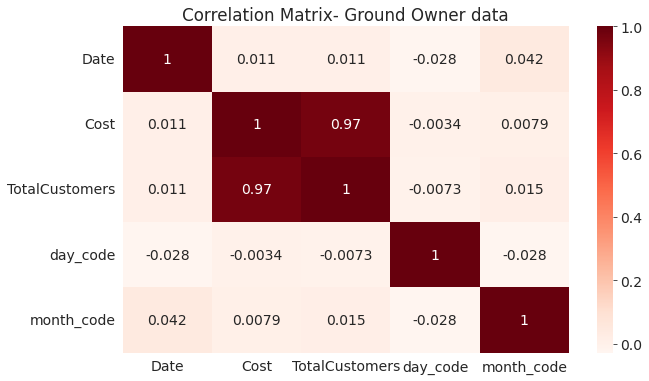

In [19]:
correlation_matrix_ground(gO1_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


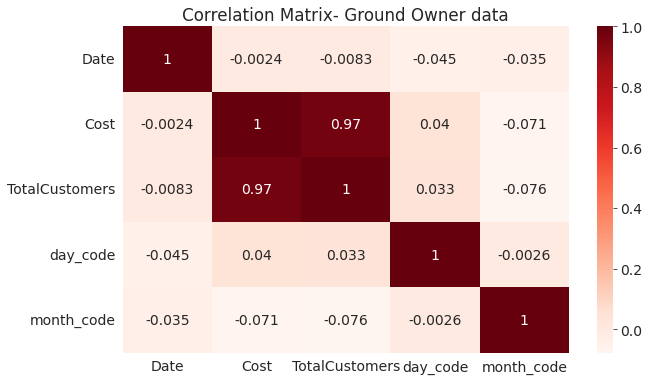

In [20]:
correlation_matrix_ground(gO2_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


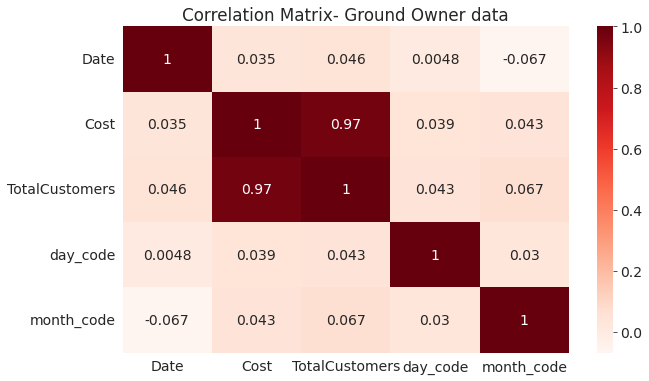

In [21]:
correlation_matrix_ground(gO3_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


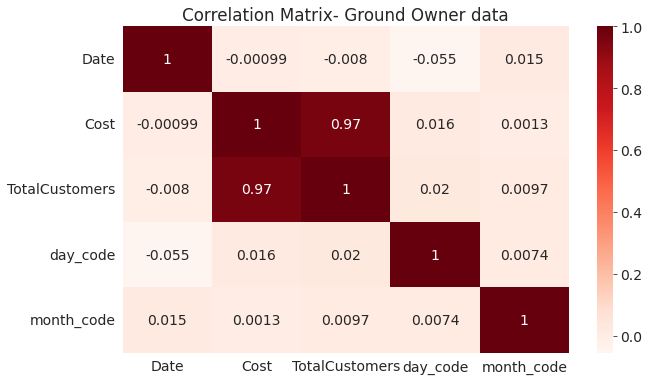

In [22]:
correlation_matrix_ground(gO4_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


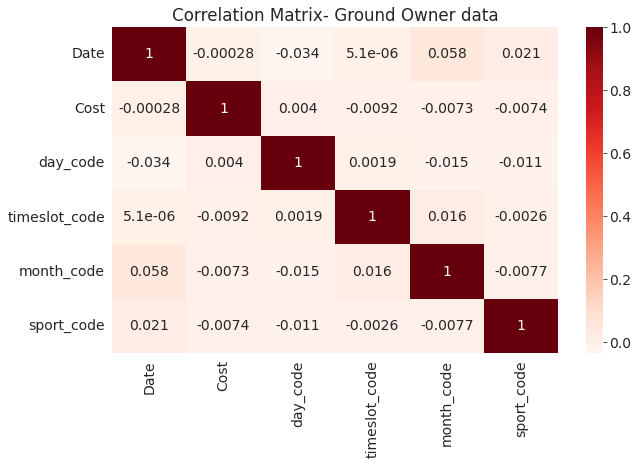

In [23]:
correlation_matrix_cust(gO1_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


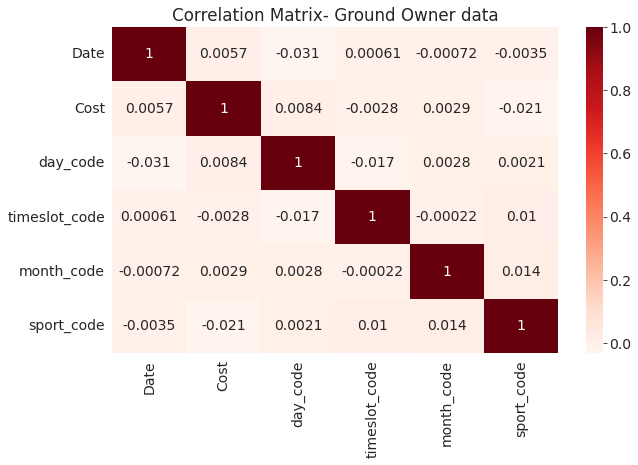

In [24]:
correlation_matrix_cust(gO2_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


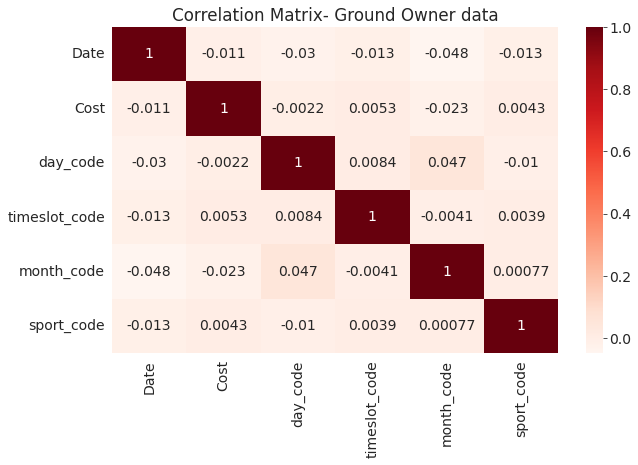

In [25]:
correlation_matrix_cust(gO3_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


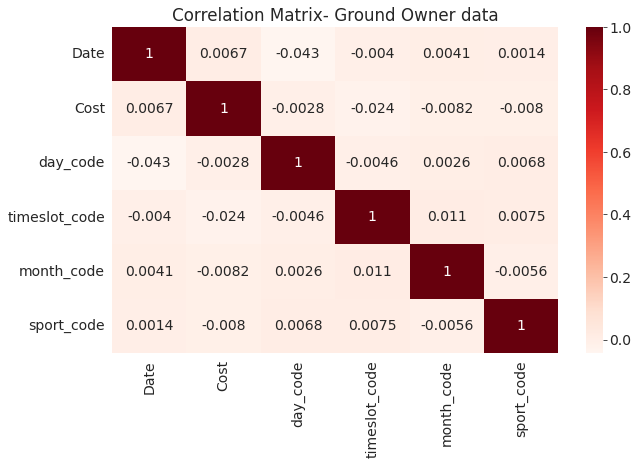

In [26]:
correlation_matrix_cust(gO4_Cust_df)

# Preprocessing for fitting into Models

In [27]:
print(gO1_Cost_df.shape)
gO1_Cost_df.head()

(720, 9)


,Date,Year,Day,Month,GroundName,Cost,TotalCustomers,day_code,month_code
6,7,2010,Monday,August,Ground1,900,5,0,7
9,10,2010,Sunday,March,Ground1,6650,23,6,2
11,12,2010,Friday,August,Ground1,2250,9,4,7
15,16,2010,Friday,March,Ground1,2500,12,4,2
16,17,2010,Tuesday,May,Ground1,3100,13,1,4


In [28]:
gO1_Cost_df.nunique()

Date              720
Year               12
Day                 7
Month              12
GroundName          1
Cost              149
TotalCustomers     26
day_code            7
month_code         12
dtype: int64

In [29]:
gO1_Cost_df = gO1_Cost_df.drop(['Date','Year','GroundName','day_code','month_code'],axis=1)
# gO1_Cost_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
gO1_Cost_df.head()

,Day,Month,Cost,TotalCustomers
6,Monday,August,900,5
9,Sunday,March,6650,23
11,Friday,August,2250,9
15,Friday,March,2500,12
16,Tuesday,May,3100,13


In [30]:
gO1_Cost_df.shape

(720, 4)

In [31]:
print(gO1_Cust_df.shape)
gO1_Cust_df.head()

(11466, 12)


,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost,day_code,timeslot_code,month_code,sport_code
110,7,2010,Monday,August,timeslot1,sport1,Ground1,400,0,0,7,0
111,7,2010,Monday,August,timeslot2,sport2,Ground1,100,0,1,7,1
112,7,2010,Monday,August,timeslot3,sport4,Ground1,150,0,2,7,3
113,7,2010,Monday,August,timeslot6,sport4,Ground1,250,0,5,7,3
135,10,2010,Sunday,March,timeslot7,sport5,Ground1,100,6,6,2,4


In [32]:
gO1_Cust_df.nunique()

Date             720
Year              12
Day                7
Month             12
TimeSlot           7
Sport              6
GroundName         1
Cost               9
day_code           7
timeslot_code      7
month_code        12
sport_code         6
dtype: int64

In [33]:
gO1_Cust_df = gO1_Cust_df.drop(['Date','Year','GroundName','day_code','month_code','timeslot_code','sport_code'],axis=1)
# gO1_Cust_df = pd.get_dummies(gO1_Cust_df,drop_first=True)
gO1_Cust_df.head()

,Day,Month,TimeSlot,Sport,Cost
110,Monday,August,timeslot1,sport1,400
111,Monday,August,timeslot2,sport2,100
112,Monday,August,timeslot3,sport4,150
113,Monday,August,timeslot6,sport4,250
135,Sunday,March,timeslot7,sport5,100


In [34]:
gO1_Cust_df.columns

Index(['Day', 'Month', 'TimeSlot', 'Sport', 'Cost'], dtype='object')

# Predicting Total cost of the ground on a day

## Simple Linear Regression

In [35]:
linear_1 = gO1_Cost_df[['TotalCustomers','Cost']]
print(linear_1.shape)
linear_1.head()

(720, 2)


,TotalCustomers,Cost
6,5,900
9,23,6650
11,9,2250
15,12,2500
16,13,3100


Text(0, 0.5, 'Revenue of that day')

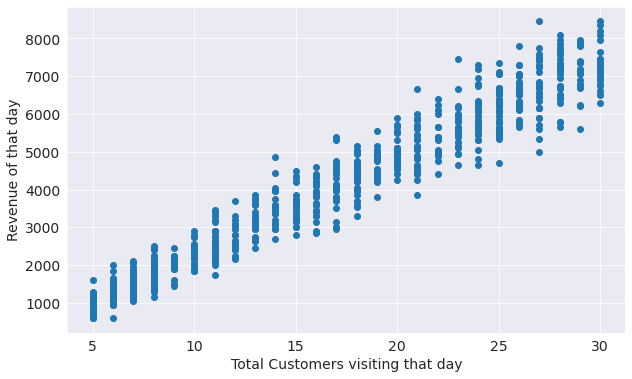

In [36]:
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [37]:
linear_1_X = linear_1.iloc[:,0:1]
linear_1_y = linear_1.iloc[:,-1]

In [38]:
linear_1_X.head()

,TotalCustomers
6,5
9,23
11,9
15,12
16,13


In [39]:
linear_1_y.head()

6      900
9     6650
11    2250
15    2500
16    3100
Name: Cost, dtype: int64

In [40]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(linear_1_X,linear_1_y,test_size = 0.2,random_state=2)

In [41]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
lr_1 = LinearRegression()


In [42]:
lr_1.fit(X_train,y_train)

LinearRegression()

In [43]:
X_test.head()

,TotalCustomers
1929,26
2101,14
544,11
457,18
2703,28


In [44]:
y_test.head()

1929    6200
2101    3600
544     2900
457     5050
2703    7350
Name: Cost, dtype: int64

In [45]:
X_test.iloc[1]

TotalCustomers    14
Name: 2101, dtype: int64

In [46]:
lr_1.predict(X_test.iloc[1].values.reshape(1,1))

array([3345.29808354])

In [47]:
#regression metrics 


Text(0, 0.5, 'Revenue of that day')

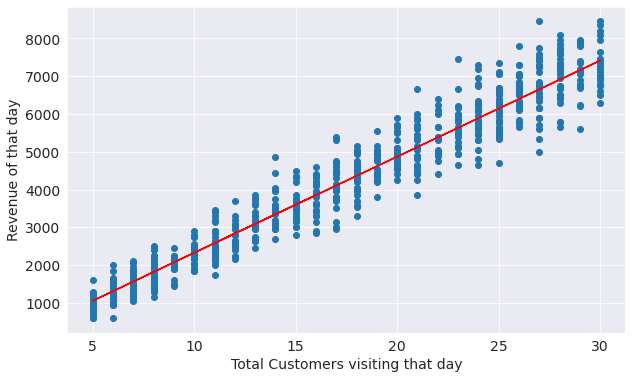

In [48]:
# line of best fit : 
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.plot(X_train.to_numpy(),lr_1.predict(X_train),color='red')
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [49]:
w_lr_1 = lr_1.coef_
b_lr_1 = lr_1.intercept_
print('weight:'+str(w_lr_1))
print('bias :'+str(b_lr_1))
# revenue = w * totalCust + b

weight:[254.35305853]
bias :-215.64473583346717


## Multiple Linear Regression

In [50]:
gO1_Cost_df

,Day,Month,Cost,TotalCustomers
6,Monday,August,900,5
9,Sunday,March,6650,23
11,Friday,August,2250,9
15,Friday,March,2500,12
16,Tuesday,May,3100,13
...,...,...,...,...
2965,Friday,July,1900,10
2968,Wednesday,August,1850,7
2971,Thursday,February,3100,14
2977,Sunday,August,4950,20


In [51]:
linear_2 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_2.shape)
print(linear_2.columns)
linear_2.head()

(720, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0


In [52]:
# 18 dimensional hyperplane
# cost = b0 + b1.totCust + b2.day_mon + ... +b17.month_sept 


In [53]:
linear_2_X = linear_2.iloc[:,1:]
linear_2_y = linear_2.iloc[:,0]

In [54]:
print(linear_2_X.shape)
print(linear_2_y.shape)

(720, 18)
(720,)


In [55]:
linear_2_X

,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2965,10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2968,7,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
2971,14,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
2977,20,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [56]:
linear_2_y

6        900
9       6650
11      2250
15      2500
16      3100
        ... 
2965    1900
2968    1850
2971    3100
2977    4950
2990    5800
Name: Cost, Length: 720, dtype: int64

In [57]:
X_train,X_test,y_train,y_test = train_test_split(linear_2_X,linear_2_y,test_size=0.2,random_state=2)

In [58]:
lr_2 = LinearRegression()

In [59]:
lr_2.fit(X_train,y_train)

LinearRegression()

In [60]:
y_pred = lr_2.predict(X_test)

In [61]:
r2_score(y_test,y_pred)

0.947595361496267

In [62]:
lr_2.coef_ # b1 to b17

array([ 253.58203957,   40.15406768,   -2.38507089,   92.1702544 ,
         67.95968153,   38.22385279,   75.00742829,  -76.38942834,
         14.46358623,  -62.51276722,  -25.60640142,  -24.64663499,
       -110.50950218, -145.79380728,   48.51385183, -145.91792208,
        -98.84737995, -125.81946282])

In [63]:
lr_2.intercept_ # bias

-188.41880743010643

In [64]:
# evalutaion metric s: MAE , MSE , RMSE , R2Score , Adjusted R2 score
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [65]:
y_pred=lr_2.predict(X_test)

In [66]:
print("MAE: Rs.",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE: Rs.",np.sqrt(mean_squared_error(y_test,y_pred)))
r2=r2_score(y_test,y_pred)
print("R2Score :",r2)


MAE: Rs. 384.0595881693411
MSE 248410.091938753
RMSE: Rs. 498.4075560610543
R2Score : 0.947595361496267


## Polynomial Regression (ohe)

In [67]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,SGDRegressor
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.metrics import r2_score
from sklearn.pipeline import Pipeline

In [68]:
linear_3 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_3.shape)
print(linear_3.columns)
linear_3.head()

(720, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0


In [69]:
linear_3_X = linear_3.iloc[:,1:]
linear_3_y = linear_3.iloc[:,0]

In [70]:
linear_3_y.head()

6      900
9     6650
11    2250
15    2500
16    3100
Name: Cost, dtype: int64

In [71]:
linear_3_X.head()

,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0


In [72]:
X_train,X_test,y_train,y_test = train_test_split(linear_3_X,linear_3_y,test_size=0.2,random_state=2)

In [73]:
poly = PolynomialFeatures(degree = 2)
X_linear3_trans = poly.fit_transform(X_train)
X_linear3_trans

array([[ 1., 11.,  0., ...,  0.,  0.,  0.],
       [ 1., 12.,  0., ...,  0.,  0.,  1.],
       [ 1., 13.,  0., ...,  0.,  0.,  0.],
       ...,
       [ 1.,  8.,  0., ...,  0.,  0.,  0.],
       [ 1., 18.,  0., ...,  0.,  0.,  0.],
       [ 1., 16.,  0., ...,  1.,  0.,  0.]])

In [74]:
lr_3 = LinearRegression()
lr_3.fit(X_linear3_trans,y_train)

LinearRegression()

In [75]:
X_linear3_test = poly.transform(X_test)
y_pred = lr_3.predict(X_linear3_test)

In [76]:
# y_pred

In [77]:
r2_score(y_test,y_pred)

0.9490443097970809

## Ridge Regression(ohe) (mse, sgd)

In [78]:
linear_4 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_4

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2965,1900,10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2968,1850,7,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
2971,3100,14,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
2977,4950,20,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [79]:
linear_4_X = linear_4.iloc[:,1:]
linear_4_y = linear_4.iloc[:,0]

In [80]:
print(linear_4_X.shape)
print(linear_4_y.shape)

(720, 18)
(720,)


In [81]:
X_train,X_test,y_train,y_test = train_test_split(linear_4_X,linear_4_y,test_size=0.2,random_state=2)

In [82]:
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score,mean_squared_error
l4_ridge = Ridge(alpha = 0.0001)
l4_ridge.fit(X_train,y_train)

Ridge(alpha=0.0001)

In [83]:
y_pred = l4_ridge.predict(X_test)

In [84]:
print("R2 score : ",r2_score(y_pred,y_test))
print("RMSE :",np.sqrt(mean_squared_error(y_test,y_pred)))

R2 score :  0.94007290184266
RMSE : 498.4075079452349


In [85]:
from sklearn.linear_model import SGDRegressor
l4_sgd = SGDRegressor(max_iter = 500,learning_rate="constant",alpha=0.001)

In [86]:
l4_sgd.fit(X_train,y_train)

SGDRegressor(alpha=0.001, learning_rate='constant', max_iter=500)

In [87]:
y_pred = l4_sgd.predict(X_test)
print("R2 score:",r2_score(y_pred,y_test))

R2 score: -3.61395970028725


In [88]:
l4_ridge_sgd = Ridge(alpha=0.001,max_iter=500,solver="sparse_cg")

In [89]:
l4_ridge_sgd.fit(X_train,y_train)

Ridge(alpha=0.001, max_iter=500, solver='sparse_cg')

In [90]:
y_pred = l4_ridge_sgd.predict(X_test)
print("R2 score:",r2_score(y_pred,y_test))

R2 score: 0.9400715605774255


## Lasso Regression(ohe)


In [91]:
from sklearn.linear_model import Lasso
import matplotlib.pyplot as plt

In [92]:
linear_5 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_5

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2965,1900,10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2968,1850,7,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
2971,3100,14,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
2977,4950,20,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [93]:
linear_5_X = linear_5.iloc[:,1:]
linear_5_y = linear_5.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(linear_5_X,linear_5_y,test_size=0.2,random_state=2)

In [94]:
coefs = []
r2_scores = []

for i in [0,0.1,1,10]:
    reg = Lasso(alpha=i)
    reg.fit(X_train,y_train)
    
    coefs.append(reg.coef_.tolist())
    y_pred = reg.predict(X_test)
    r2_scores.append(r2_score(y_test,y_pred))

Index(['TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')
Alpha = 0, r2_score=0.95
Alpha = 0, r2_score=0.95
Alpha = 0, r2_score=0.95
Alpha = 0, r2_score=0.95


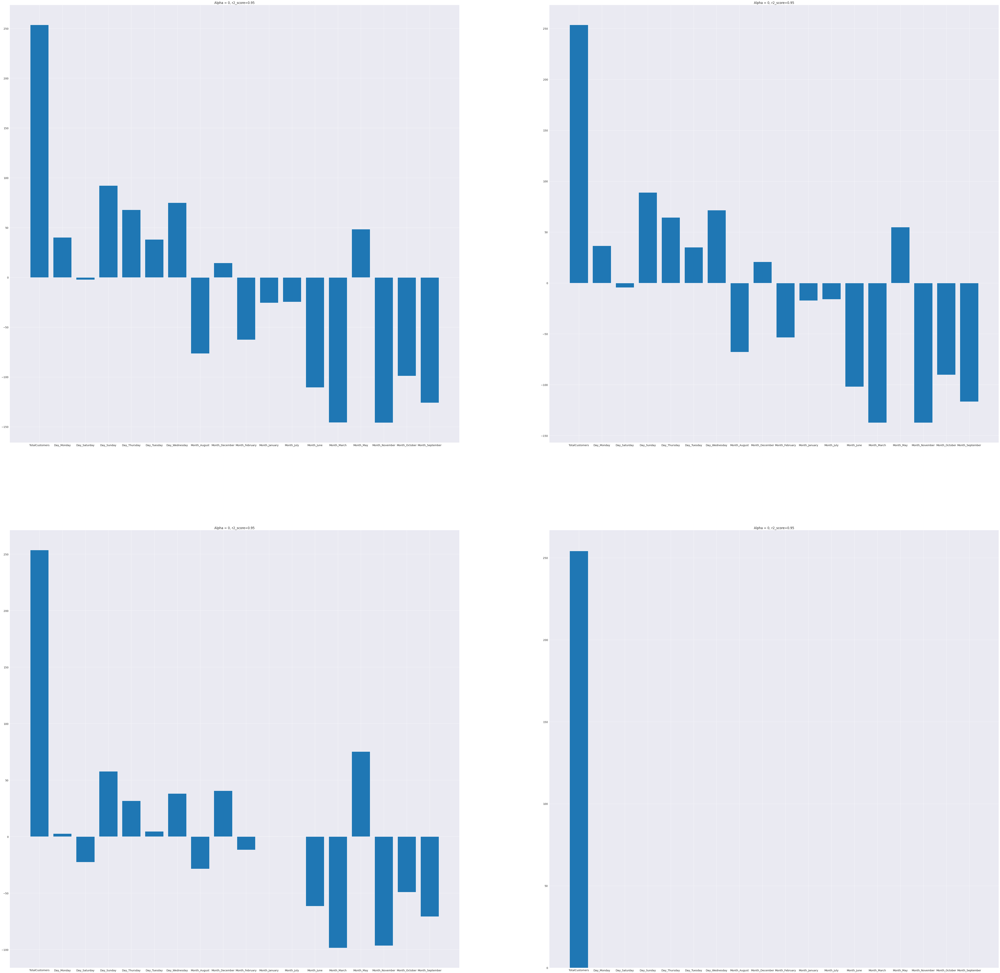

In [95]:
print(linear_5_X.columns)
plt.figure(figsize=(95,95))
plt.subplot(221)
plt.bar(linear_5_X.columns,coefs[0])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[0],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[0],2)))

plt.subplot(222)
plt.bar(linear_5_X.columns,coefs[1])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[1],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[1],2)))


plt.subplot(223)
plt.bar(linear_5_X.columns,coefs[2])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[2],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[2],2)))

plt.subplot(224)
plt.bar(linear_5_X.columns,coefs[3])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[3],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[3],2)))


In [96]:
# features : total customers, August month, june month , march month affect the most 
# use ridge when you know all features are important : L2 regularization does not eliminate the features completely
# use lasso when you know its fine to eliminate featuers : L1 regularization eleminates features 

## ElasticNet Regression (ohe)

In [97]:
#if you do not know the importance of your columns, use elastic Net regression 
#its loss function is a combination of both lasso and ridge
# also used when there is multi collinearity between input columns

In [98]:
from sklearn.linear_model import LinearRegression,ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

In [99]:
linear_6 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_6

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2965,1900,10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2968,1850,7,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
2971,3100,14,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
2977,4950,20,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [100]:
linear_6_X = linear_6.iloc[:,1:]
linear_6_y = linear_6.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(linear_6_X,linear_6_y,test_size=0.2,random_state=2)

In [101]:
l6_elasticNet = ElasticNet(alpha=0.005,l1_ratio=0.9)
l6_elasticNet.fit(X_train,y_train)

ElasticNet(alpha=0.005, l1_ratio=0.9)

In [102]:
y_pred = l6_elasticNet.predict(X_test)

In [103]:
r2_score(y_test,y_pred)

0.9476254468843093

## Regression Tree (ohe)

In [104]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.metrics import r2_score

In [105]:
regt_1 = pd.get_dummies(gO1_Cost_df,drop_first=True)
regt_1

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
6,900,5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,6650,23,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11,2250,9,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
15,2500,12,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
16,3100,13,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2965,1900,10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2968,1850,7,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
2971,3100,14,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0
2977,4950,20,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [106]:
regt_1_X = regt_1.iloc[:,1:]
regt_1_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(regt_1_X,regt_1_y,test_size=0.2,random_state=2)

In [107]:
regt1 = DecisionTreeRegressor(criterion='mse',max_depth = 5)
regt1.fit(X_train,y_train)

DecisionTreeRegressor(criterion='mse', max_depth=5)

In [108]:
y_pred = regt1.predict(X_test)

In [109]:
r2_score(y_test,y_pred)

0.9419432640561222

In [110]:
#hyperparameter tuning 
param_grid = {
    'max_depth':[2,4,6,8,10],
    'criterion':['mse','mae'],
    'max_features':[0.25,0.5,1.0],
    'min_samples_split':[0.25,0.5,1.0]
}
regt2= GridSearchCV(DecisionTreeRegressor(),param_grid=param_grid)
regt2.fit(X_train,y_train)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [2, 4, 6, 8, 10],
                         'max_features': [0.25, 0.5, 1.0],
                         'min_samples_split': [0.25, 0.5, 1.0]})

In [111]:
regt2.best_score_

0.910145005594692

In [112]:
regt2.best_params_

{'criterion': 'mse',
 'max_depth': 4,
 'max_features': 1.0,
 'min_samples_split': 0.25}

## Voting : Linear Regressor, regression tree, support vector regressor ,polynomial  (ohe) 

In [114]:
# mean of outputs of multiple models
voting_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
voting_X = regt_1.iloc[:,1:]
voting_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(voting_X,voting_y,test_size=0.2,random_state=2)

In [115]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score


In [116]:
print(lr_2) # multiple linear regression 
print(lr_3) # polymonial regression
print(l4_ridge) # ridge regression
l5_lasso = Lasso(alpha=1)
print(l5_lasso) #lasso reg
print(l6_elasticNet) #elastic net reg
print(regt1) #decision tree regression
svr=SVR()
print(svr) #support vector regressor

LinearRegression()
LinearRegression()
Ridge(alpha=0.0001)
Lasso(alpha=1)
ElasticNet(alpha=0.005, l1_ratio=0.9)
DecisionTreeRegressor(criterion='mse', max_depth=5)
SVR()


In [117]:
estimators = [('lr_2',lr_2),('lr_3',lr_3),('l4_ridge',l4_ridge),('l5_lasso',l5_lasso),('l6_elasticNet',l6_elasticNet),('regt1',regt1),('svr',svr)]

In [118]:
estimators

[('lr_2', LinearRegression()),
 ('lr_3', LinearRegression()),
 ('l4_ridge', Ridge(alpha=0.0001)),
 ('l5_lasso', Lasso(alpha=1)),
 ('l6_elasticNet', ElasticNet(alpha=0.005, l1_ratio=0.9)),
 ('regt1', DecisionTreeRegressor(criterion='mse', max_depth=5)),
 ('svr', SVR())]

In [119]:
from sklearn.ensemble import VotingRegressor
vr = VotingRegressor(estimators)
scores = cross_val_score(vr,X_train,y_train,scoring='r2',cv=10)
print("Voting regressor : ",np.round(np.mean(scores),2))

Voting regressor :  0.92


## Bagging : Linear Regressor, regression tree, kneighbors regressor ,polynomial  (ohe) 

In [120]:
# data fed into the model in bootstrap phase is subsets of original dataset
# aggregation is done using voting 

In [121]:
bagging_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
bagging_X = regt_1.iloc[:,1:]
bagging_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(bagging_X,bagging_y,test_size=0.2,random_state=2)

In [122]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingRegressor

bag_regressor = BaggingRegressor(random_state=1)
bag_regressor.fit(X_train,y_train)

BaggingRegressor(random_state=1)

In [123]:
y_preds = bag_regressor.predict(X_test)

In [124]:
r2_score(y_test,y_preds)

0.9357186692576233

In [125]:
#finding which base estimator provides best results 
n_samples = X_train.shape[0]
n_features = X_train.shape[1]

params = {
    'base_estimator' : [lr_2,lr_3,l4_ridge,l5_lasso,l6_elasticNet,regt1,svr],
    'n_estimators':[20,50,100],
    'max_samples':[0.5,1.0],
    'max_features':[0.5,1.0],
    'bootstrap':[True,False],
    'bootstrap_features':[True,False]
}

bagging_reg_grid = GridSearchCV(BaggingRegressor(random_state=1,n_jobs=-1),param_grid=params,cv=3,n_jobs=-1,verbose=1)
bagging_reg_grid.fit(X_train,y_train)

Fitting 3 folds for each of 336 candidates, totalling 1008 fits


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.370e+06, tolerance: 1.376e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.783e+06, tolerance: 1.535e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.302e+06, tolerance: 1.360e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.454e+05, tolerance: 1.472e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.168e+05, tolerance: 1.462e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.399e+05, tolerance: 1.492e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.264e+07, tolerance: 1.638e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.105e+06, tolerance: 1.488e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.634e+05, tolerance: 1.583e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.547e+07, tolerance: 1.586e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.093e+07, tolerance: 1.566e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.847e+07, tolerance: 1.512e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.086e+06, tolerance: 1.382e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.683e+06, tolerance: 1.496e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.826e+07, tolerance: 1.371e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.379e+07, tolerance: 1.386e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.768e+07, tolerance: 1.689e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.492e+07, tolerance: 1.533e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.692e+07, tolerance: 1.590e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.815e+07, tolerance: 1.534e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.485e+07, tolerance: 1.639e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.625e+05, tolerance: 1.402e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.927e+07, tolerance: 1.539e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.464e+07, tolerance: 1.553e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.766e+07, tolerance: 1.491e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.022e+06, tolerance: 1.584e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.717e+07, tolerance: 1.520e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.872e+07, tolerance: 1.590e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.906e+07, tolerance: 1.499e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.016e+06, tolerance: 1.515e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.198e+06, tolerance: 1.499e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.372e+07, tolerance: 1.558e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.212e+07, tolerance: 1.529e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.092e+07, tolerance: 1.620e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.447e+07, tolerance: 1.520e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.464e+07, tolerance: 1.687e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.118e+07, tolerance: 1.529e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.332e+07, tolerance: 1.503e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.147e+07, tolerance: 1.642e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.902e+07, tolerance: 1.499e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.192e+07, tolerance: 1.417e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.707e+06, tolerance: 1.544e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.854e+07, tolerance: 1.499e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.154e+07, tolerance: 1.529e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.111e+06, tolerance: 1.544e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.337e+07, tolerance: 1.544e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.202e+06, tolerance: 1.499e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.671e+07, tolerance: 1.529e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.157e+05, tolerance: 1.544e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.661e+05, tolerance: 1.544e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

GridSearchCV(cv=3, estimator=BaggingRegressor(n_jobs=-1, random_state=1),
             n_jobs=-1,
             param_grid={'base_estimator': [LinearRegression(),
                                            LinearRegression(),
                                            Ridge(alpha=0.0001), Lasso(alpha=1),
                                            ElasticNet(alpha=0.005,
                                                       l1_ratio=0.9),
                                            DecisionTreeRegressor(criterion='mse',
                                                                  max_depth=5),
                                            SVR()],
                         'bootstrap': [True, False],
                         'bootstrap_features': [True, False],
                         'max_features': [0.5, 1.0], 'max_samples': [0.5, 1.0],
                         'n_estimators': [20, 50, 100]},
             verbose=1)

In [126]:
print("Train r2 score : %.3f"%bagging_reg_grid.best_estimator_.score(X_train,y_train))
print("Test r2 score: %.3f"%bagging_reg_grid.best_estimator_.score(X_test,y_test))
print("Best r2 score through grid search : %.3f"%bagging_reg_grid.best_score_)
print("Best parameters : ",bagging_reg_grid.best_params_)

Train r2 score : 0.941
Test r2 score: 0.948
Best r2 score through grid search : 0.937
Best parameters :  {'base_estimator': Lasso(alpha=1), 'bootstrap': False, 'bootstrap_features': False, 'max_features': 1.0, 'max_samples': 1.0, 'n_estimators': 20}


## XG Boosting

# Predicting probable timeslot , sport 

In [127]:
sport_df = gO1_Cust_df[["Day","Month","Cost","Sport"]]
sport_df

,Day,Month,Cost,Sport
110,Monday,August,400,sport1
111,Monday,August,100,sport2
112,Monday,August,150,sport4
113,Monday,August,250,sport4
135,Sunday,March,100,sport5
...,...,...,...,...
49630,Monday,February,100,sport2
49631,Monday,February,100,sport5
49632,Monday,February,250,sport6
49633,Monday,February,150,sport5


## Decision Tree

### sport

In [128]:
dt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
dt1_sport.head()


,Day,Month,TimeSlot,Sport
110,Monday,August,timeslot1,sport1
111,Monday,August,timeslot2,sport2
112,Monday,August,timeslot3,sport4
113,Monday,August,timeslot6,sport4
135,Sunday,March,timeslot7,sport5


In [129]:
dt1_sport_y = dt1_sport[["Sport"]]
dt1_sport_y

,Sport
110,sport1
111,sport2
112,sport4
113,sport4
135,sport5
...,...
49630,sport2
49631,sport5
49632,sport6
49633,sport5


In [130]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(dt1_sport_y)
dt1_sport_y_le = le.transform(dt1_sport_y)
print(dt1_sport_y_le.size)
print(type(dt1_sport_y_le))
dt1_sport_y_le

11466
<class 'numpy.ndarray'>


array([0, 1, 3, ..., 5, 4, 2])

In [131]:
dt1_sport_X = dt1_sport[["Day","Month","TimeSlot"]]
dt1_sport_X

,Day,Month,TimeSlot
110,Monday,August,timeslot1
111,Monday,August,timeslot2
112,Monday,August,timeslot3
113,Monday,August,timeslot6
135,Sunday,March,timeslot7
...,...,...,...
49630,Monday,February,timeslot6
49631,Monday,February,timeslot2
49632,Monday,February,timeslot1
49633,Monday,February,timeslot7


In [132]:
dt1_sport_X_ohe = pd.get_dummies(dt1_sport_X,drop_first=True)
print(dt1_sport_X_ohe.columns)
dt1_sport_X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_May,Month_November,Month_October,Month_September,TimeSlot_timeslot2,TimeSlot_timeslot3,TimeSlot_timeslot4,TimeSlot_timeslot5,TimeSlot_timeslot6,TimeSlot_timeslot7
110,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
111,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0
112,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,1,0,0,0,0
113,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
135,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49630,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
49631,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
49632,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
49633,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [133]:
X_train,X_test,y_train,y_test = train_test_split(dt1_sport_X_ohe,dt1_sport_y,test_size=0.2,random_state=5)

In [134]:
print("Train shape",X_train.shape)
print("Test shape",X_test.shape)

Train shape (9172, 23)
Test shape (2294, 23)


In [135]:
from sklearn.tree import DecisionTreeClassifier
dt1_model_sport = DecisionTreeClassifier(random_state = 54)

In [136]:
dt1_model_sport.fit(X_train,y_train)

DecisionTreeClassifier(random_state=54)

In [137]:
train_preds = dt1_model_sport.predict(X_train)

In [138]:
from sklearn.metrics import accuracy_score,confusion_matrix

In [139]:
train_preds 

array(['sport4', 'sport2', 'sport1', ..., 'sport6', 'sport5', 'sport6'],
      dtype=object)

In [140]:
pd.value_counts(train_preds)

sport1    2236
sport2    2033
sport3    1513
sport5    1249
sport4    1100
sport6    1041
dtype: int64

In [141]:
#training accuracy : 
accuracy_score(train_preds,y_train)

0.3010248582642826

In [142]:
# train_probs = dt1_model_sport.predict_proba(X_train)

In [143]:
# train_probs

In [144]:
dt1_model_sport.score(X_test,y_test)

0.16652136006974716

[Text(0.6032608695652174, 0.9166666666666666, 'TimeSlot_timeslot5 <= 0.5\ngini = 0.833\nsamples = 9172\nvalue = [1524, 1594, 1519, 1470, 1554, 1511]'),
 Text(0.3423913043478261, 0.75, 'TimeSlot_timeslot4 <= 0.5\ngini = 0.833\nsamples = 7834\nvalue = [1304, 1357, 1276, 1292, 1314, 1291]'),
 Text(0.17391304347826086, 0.5833333333333334, 'Month_June <= 0.5\ngini = 0.833\nsamples = 6555\nvalue = [1102, 1121, 1054, 1104, 1072, 1102]'),
 Text(0.08695652173913043, 0.4166666666666667, 'Month_September <= 0.5\ngini = 0.833\nsamples = 6116\nvalue = [1014, 1041, 976, 1030, 1018, 1037]'),
 Text(0.043478260869565216, 0.25, 'Month_July <= 0.5\ngini = 0.833\nsamples = 5712\nvalue = [957, 980, 909, 967, 937, 962]'),
 Text(0.021739130434782608, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.06521739130434782, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.13043478260869565, 0.25, 'TimeSlot_timeslot7 <= 0.5\ngini = 0.831\nsamples = 404\nvalue = [57, 61, 67, 63, 81, 75]'),
 Text(0.10869565217391304, 0.08

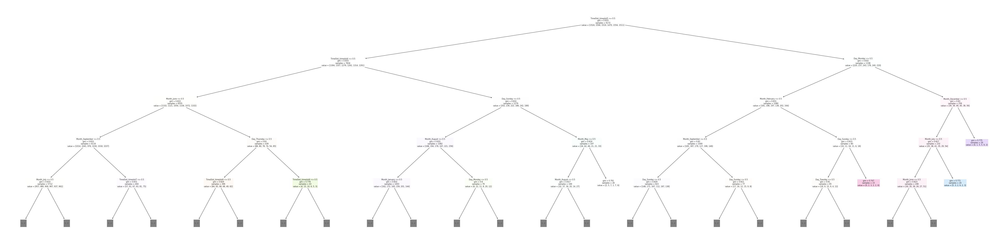

In [145]:
from sklearn.tree import plot_tree, export_text
plt.figure(figsize=(80,20))
plot_tree(dt1_model_sport,feature_names=X_train.columns,max_depth=4,filled=True)

In [146]:
# loss / cost = gini score : perfect : gini score = 0
print(dt1_model_sport.tree_.max_depth)

23


In [147]:
tree_text = export_text(dt1_model_sport,max_depth = 23, feature_names = list(X_train.columns))
print(tree_text[:50000])

|--- TimeSlot_timeslot5 <= 0.50
|   |--- TimeSlot_timeslot4 <= 0.50
|   |   |--- Month_June <= 0.50
|   |   |   |--- Month_September <= 0.50
|   |   |   |   |--- Month_July <= 0.50
|   |   |   |   |   |--- TimeSlot_timeslot2 <= 0.50
|   |   |   |   |   |   |--- Day_Thursday <= 0.50
|   |   |   |   |   |   |   |--- Month_January <= 0.50
|   |   |   |   |   |   |   |   |--- Month_November <= 0.50
|   |   |   |   |   |   |   |   |   |--- Day_Wednesday <= 0.50
|   |   |   |   |   |   |   |   |   |   |--- Month_March <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |--- TimeSlot_timeslot3 <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |--- Day_Sunday <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |--- TimeSlot_timeslot6 <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Month_May <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Day_Saturday <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Day_Mond

In [148]:
dt1_model_sport.feature_importances_

array([0.06707667, 0.06259518, 0.06011997, 0.04636032, 0.07913856,
       0.06290504, 0.04482069, 0.05033136, 0.05076827, 0.02823665,
       0.02555354, 0.01876906, 0.03996346, 0.04618942, 0.03557649,
       0.05104757, 0.0159488 , 0.02070036, 0.06072733, 0.00445129,
       0.00365319, 0.05051901, 0.07454781])

In [149]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':dt1_model_sport.feature_importances_
}).sort_values('importance',ascending=False)

In [150]:
importance_df

,feature,importance
4,Day_Tuesday,0.079139
22,TimeSlot_timeslot7,0.074548
0,Day_Monday,0.067077
5,Day_Wednesday,0.062905
1,Day_Saturday,0.062595
18,TimeSlot_timeslot3,0.060727
2,Day_Sunday,0.060120
15,Month_October,0.051048
8,Month_February,0.050768
21,TimeSlot_timeslot6,0.050519


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

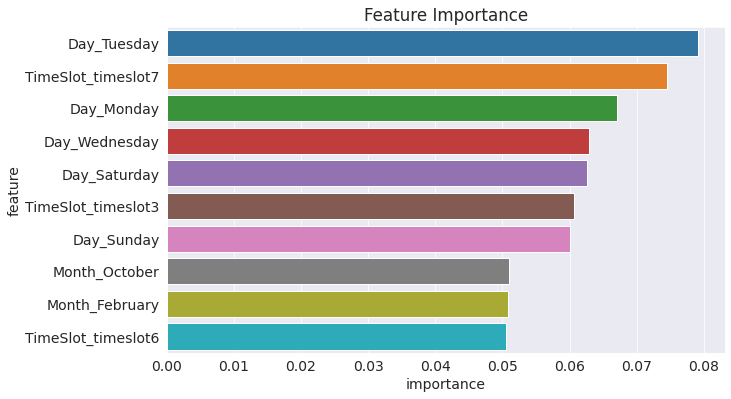

In [151]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [152]:
# regularization : reduce overfitting using hyperparameter tuning : hyperparameters are params that we specify
?DecisionTreeClassifier

In [153]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth = md, random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Training Error':train_err,'Validation Error':val_err}

In [154]:
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1,40)])

In [155]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.825556,0.840453
1,2,0.823266,0.833915
2,3,0.817597,0.836966
3,4,0.812037,0.838710
4,5,0.808439,0.826068
5,6,0.802006,0.820837
6,7,0.796337,0.834350
7,8,0.787942,0.837402
8,9,0.777802,0.836966
9,10,0.769952,0.836530


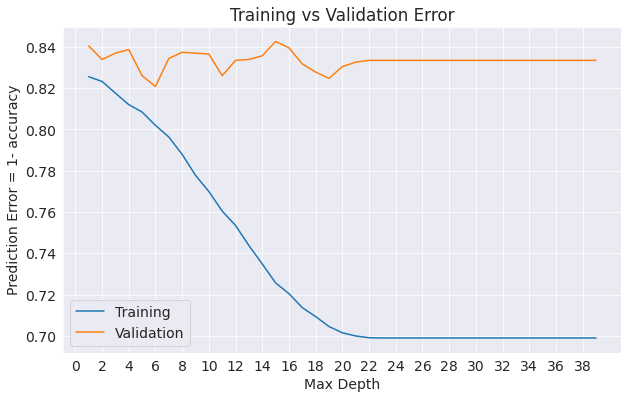

In [156]:
plt.figure()
plt.plot(errors_df['Max Depth'],errors_df['Training Error'])
plt.plot(errors_df['Max Depth'],errors_df['Validation Error'])
plt.title('Training vs Validation Error')
plt.xticks(range(0,40,2))
plt.xlabel('Max Depth')
plt.ylabel('Prediction Error = 1- accuracy')
plt.legend(['Training','Validation'])

In [157]:
# best depth for the tree is 18
model = DecisionTreeClassifier(max_depth = 18, random_state=42)
model.fit(X_train,y_train)
print(model.score(X_train,y_train))
model.score(X_test,y_test)
   

0.29066724814653294


0.17218831734960768

In [158]:
# another hyperparameter : max leaf nodes 
def max_depth_leaf_error(md,ml):
    model = DecisionTreeClassifier(max_depth = md,max_leaf_nodes=ml,random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Max Leafs':ml,'Training Error':train_err,'Validation Error':val_err}

In [159]:
errors_df = pd.DataFrame([max_depth_leaf_error(md,md+50) for md in range(1,40) ])

In [160]:
errors_df

,Max Depth,Max Leafs,Training Error,Validation Error
0,1,51,0.825556,0.840453
1,2,52,0.823266,0.833915
2,3,53,0.817597,0.836966
3,4,54,0.812037,0.838710
4,5,55,0.808439,0.826068
5,6,56,0.802006,0.820837
6,7,57,0.796664,0.834350
7,8,58,0.793611,0.835658
8,9,59,0.789359,0.840017
9,10,60,0.788814,0.836966


### timeslot

In [161]:
dt1_timeslot = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
dt1_timeslot.head()

,Day,Month,TimeSlot,Sport
110,Monday,August,timeslot1,sport1
111,Monday,August,timeslot2,sport2
112,Monday,August,timeslot3,sport4
113,Monday,August,timeslot6,sport4
135,Sunday,March,timeslot7,sport5


In [162]:
dt1_timeslot_X = dt1_timeslot[["Day","Month","Sport"]]
dt1_timeslot_X_ohe = pd.get_dummies(dt1_timeslot_X,drop_first=True)
print(dt1_timeslot_X_ohe.columns)
dt1_timeslot_X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'Sport_sport2', 'Sport_sport3', 'Sport_sport4',
       'Sport_sport5', 'Sport_sport6'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_March,Month_May,Month_November,Month_October,Month_September,Sport_sport2,Sport_sport3,Sport_sport4,Sport_sport5,Sport_sport6
110,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
111,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,1,0,0,0,0
112,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
113,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
135,0,0,1,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49630,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,0,0,0
49631,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
49632,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
49633,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0


In [163]:
dt1_timeslot_y = dt1_timeslot[["TimeSlot"]]
dt1_timeslot_y.describe()

,TimeSlot
count,11466
unique,7
top,timeslot7
freq,1677


In [164]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(dt1_timeslot_y)
dt1_timeslot_y_le = le.transform(dt1_timeslot_y)
print(dt1_timeslot_y_le.size)
print(type(dt1_timeslot_y_le))
dt1_timeslot_y_le

11466
<class 'numpy.ndarray'>


array([0, 1, 2, ..., 0, 6, 3])

In [165]:
X_train,X_test,y_train,y_test = train_test_split(dt1_timeslot_X_ohe,dt1_timeslot_y,test_size=0.2,random_state=5)

In [166]:
print("Train shape",X_train.shape)
print("Test shape",X_test.shape)

Train shape (9172, 22)
Test shape (2294, 22)


In [167]:
from sklearn.tree import DecisionTreeClassifier
dt1_model_timeslot = DecisionTreeClassifier(random_state = 54)

In [168]:
dt1_model_timeslot.fit(X_train,y_train)

DecisionTreeClassifier(random_state=54)

In [169]:
train_preds = dt1_model_timeslot.predict(X_train)

In [170]:
from sklearn.metrics import accuracy_score,confusion_matrix

In [171]:
train_preds 

array(['timeslot6', 'timeslot5', 'timeslot5', ..., 'timeslot6',
       'timeslot4', 'timeslot4'], dtype=object)

In [172]:
pd.value_counts(train_preds)

timeslot1    1923
timeslot3    1496
timeslot2    1322
timeslot4    1259
timeslot5    1236
timeslot7    1049
timeslot6     887
dtype: int64

In [173]:
#training accuracy : 
accuracy_score(train_preds,y_train)

0.27147841255996513

In [174]:
dt1_model_timeslot.score(X_test,y_test)

0.14036617262423715

[Text(0.6032608695652174, 0.9166666666666666, 'Day_Wednesday <= 0.5\ngini = 0.857\nsamples = 9172\nvalue = [1331, 1311, 1287, 1279, 1338, 1304, 1322]'),
 Text(0.3423913043478261, 0.75, 'Sport_sport4 <= 0.5\ngini = 0.857\nsamples = 7994\nvalue = [1174, 1109, 1146, 1110, 1185, 1133, 1137]'),
 Text(0.17391304347826086, 0.5833333333333334, 'Day_Tuesday <= 0.5\ngini = 0.857\nsamples = 6735\nvalue = [992, 931, 937, 950, 1031, 946, 948]'),
 Text(0.08695652173913043, 0.4166666666666667, 'Month_July <= 0.5\ngini = 0.857\nsamples = 5689\nvalue = [842, 782, 784, 810, 894, 807, 770]'),
 Text(0.043478260869565216, 0.25, 'Day_Saturday <= 0.5\ngini = 0.857\nsamples = 5286\nvalue = [775, 714, 719, 762, 830, 757, 729]'),
 Text(0.021739130434782608, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.06521739130434782, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.13043478260869565, 0.25, 'Day_Thursday <= 0.5\ngini = 0.853\nsamples = 403\nvalue = [67, 68, 65, 48, 64, 50, 41]'),
 Text(0.10869565217391304, 0.

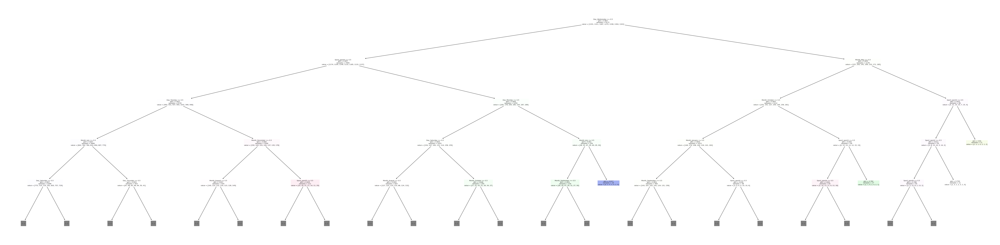

In [175]:
from sklearn.tree import plot_tree, export_text
plt.figure(figsize=(80,20))
plot_tree(dt1_model_timeslot,feature_names=X_train.columns,max_depth=4,filled=True)

In [176]:
# loss / cost = gini score : perfect : gini score = 0
print(dt1_model_timeslot.tree_.max_depth)

22


In [177]:
dt1_model_timeslot.feature_importances_

array([0.05619252, 0.01152251, 0.0890885 , 0.07910446, 0.01744376,
       0.00561178, 0.04300132, 0.02192066, 0.02353076, 0.02718389,
       0.02749508, 0.04326089, 0.02849157, 0.04933538, 0.02510647,
       0.02383374, 0.04800266, 0.08898444, 0.07405154, 0.02885522,
       0.10424171, 0.08374113])

In [178]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':dt1_model_timeslot.feature_importances_
}).sort_values('importance',ascending=False)

In [179]:
importance_df

,feature,importance
20,Sport_sport5,0.104242
2,Day_Sunday,0.089088
17,Sport_sport2,0.088984
21,Sport_sport6,0.083741
3,Day_Thursday,0.079104
18,Sport_sport3,0.074052
0,Day_Monday,0.056193
13,Month_May,0.049335
16,Month_September,0.048003
11,Month_June,0.043261


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

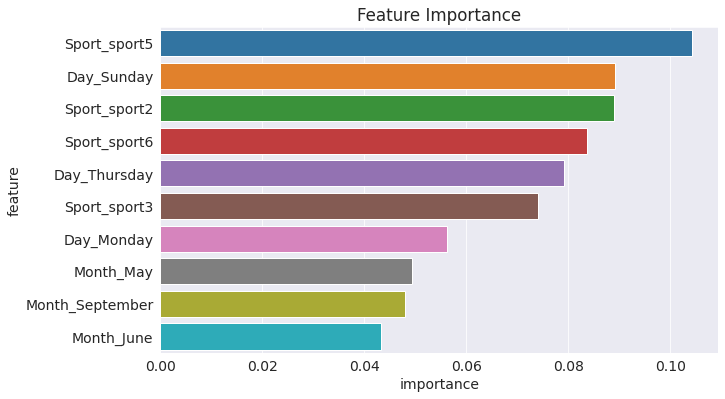

In [180]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [181]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth = md, random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Training Error':train_err,'Validation Error':val_err}

In [182]:
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1,40)])

In [183]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.848779,0.855275
1,2,0.842346,0.855711
2,3,0.837222,0.857890
3,4,0.833515,0.857890
4,5,0.830898,0.858326
5,6,0.825447,0.857018
6,7,0.815526,0.855275
7,8,0.807457,0.854839
8,9,0.797318,0.851787
9,10,0.790994,0.852659


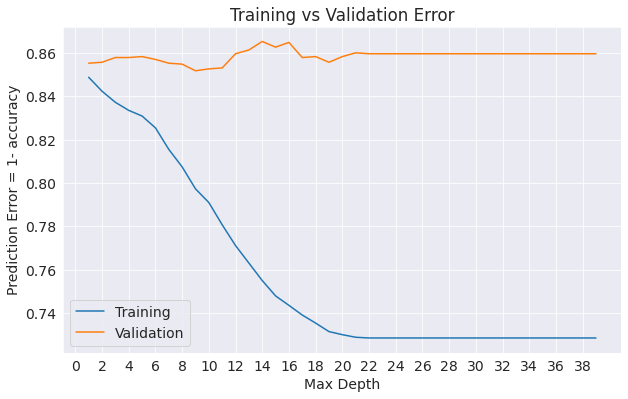

In [184]:
plt.figure()
plt.plot(errors_df['Max Depth'],errors_df['Training Error'])
plt.plot(errors_df['Max Depth'],errors_df['Validation Error'])
plt.title('Training vs Validation Error')
plt.xticks(range(0,40,2))
plt.xlabel('Max Depth')
plt.ylabel('Prediction Error = 1- accuracy')
plt.legend(['Training','Validation'])

In [185]:
# best depth for the tree is 4
model = DecisionTreeClassifier(max_depth = 4, random_state=42)
model.fit(X_train,y_train)
print(model.score(X_train,y_train))
model.score(X_test,y_test)
   

0.16648495420846054


0.14210985178727115

In [186]:
# another hyperparameter : max leaf nodes 
def max_depth_leaf_error(md,ml):
    model = DecisionTreeClassifier(max_depth = md,max_leaf_nodes=ml,random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Max Leafs':ml,'Training Error':train_err,'Validation Error':val_err}

In [187]:
errors_df = pd.DataFrame([max_depth_leaf_error(md,md+150) for md in range(1,40) ])

In [188]:
errors_df

,Max Depth,Max Leafs,Training Error,Validation Error
0,1,151,0.848779,0.855275
1,2,152,0.842346,0.855711
2,3,153,0.837222,0.857890
3,4,154,0.833515,0.857890
4,5,155,0.830898,0.858326
5,6,156,0.825447,0.857018
6,7,157,0.815526,0.855275
7,8,158,0.807457,0.854839
8,9,159,0.797318,0.851787
9,10,160,0.790994,0.852659


## Random Forest 

### sport

In [189]:
#most commonly occuring class
from sklearn.ensemble import RandomForestClassifier

In [190]:
rf_sport = RandomForestClassifier(n_jobs=-1,random_state=42)

In [191]:
X_train,X_test,y_train,y_test = train_test_split(dt1_sport_X_ohe,dt1_sport_y,test_size=0.2,random_state=5)

In [192]:
rf_sport.fit(X_train,y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [193]:
rf_sport.score(X_train,y_train)

0.3009158307893589

In [194]:
rf_sport.score(X_test,y_test)

0.16826503923278116

In [195]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':rf_sport.feature_importances_
}).sort_values('importance',ascending=False)

In [196]:
importance_df

,feature,importance
4,Day_Tuesday,0.057478
1,Day_Saturday,0.056749
18,TimeSlot_timeslot3,0.056680
17,TimeSlot_timeslot2,0.054886
21,TimeSlot_timeslot6,0.054732
0,Day_Monday,0.054375
22,TimeSlot_timeslot7,0.052418
2,Day_Sunday,0.052344
5,Day_Wednesday,0.049081
19,TimeSlot_timeslot4,0.046856


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

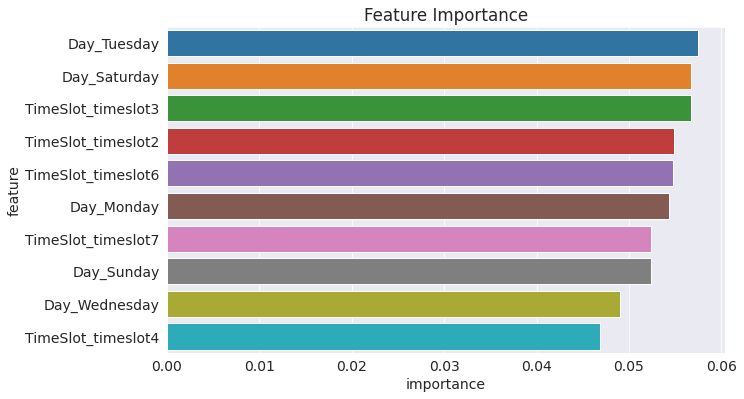

In [197]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [241]:
#hyperparameter tuning 
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score

In [242]:
np.mean(cross_val_score(rf_sport,X_train,y_train,cv=10,scoring='accuracy'))

0.1651767746963077

In [243]:
n_estimators=[20,60,100,120]
max_features= [0.2,0.6,1.0]
max_depth = [2,8]
max_samples = [0.5,0.75,1.0]

In [244]:
param_grid = {
    'n_estimators' : n_estimators,
    'max_features': max_features,
    'max_depth' : max_depth,
    'max_samples': max_samples
}

In [245]:
from sklearn.model_selection import GridSearchCV

rf_grid = GridSearchCV(estimator = rf_sport,
                      param_grid = param_grid,
                      cv=5,
                      verbose = 2,
                      n_jobs = -1
                      )

In [246]:
rf_grid.fit(X_train,y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 8], 'max_features': [0.2, 0.6, 1.0],
                         'max_samples': [0.5, 0.75, 1.0],
                         'n_estimators': [20, 60, 100, 120]},
             verbose=2)

In [248]:
rf_grid.best_params_

{'max_depth': 2, 'max_features': 0.2, 'max_samples': 0.5, 'n_estimators': 20}

[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=60; total time=   0.4s
[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=120; total time=   0.7s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=100; total time=   0.5s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=120; total time=   0.7s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=100; total time=   0.5s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=120; total time=   0.7s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estimators=120; total time=   0.7s
[CV] END max_depth=2, max_features=0.6, max_samples=0.75, n_estimators=60; total time=   0.4s
[CV] END max_depth=2, max_features=0.6, max_samples=0.75, n_estimators=120; total time=   0.8s
[CV] END max_depth=2, max_features=0.6, max_samples=1.0, n_

[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=100; total time=   0.5s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=120; total time=   0.6s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=100; total time=   0.6s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_esti

[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=0.5, n_estimators=120; total time=   0.6s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=0.75, n_estimators=100; total time=   0.5s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=20; total time=   0.1s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=60; total time=   0.3s
[CV] END max_depth=2, max_features=0.2, max_samples=1.0, n_estimators=120; total time=   0.7s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estimators=20; total time=   0.2s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estimators=100; total time=   0.6s
[CV] END max_depth=2, max_features=0.6, max_samples=0.5, n_estim

In [247]:
rf_grid.best_score_

0.17378996193606086

### timeslot

## Voting Classification 

### sport

In [199]:
vt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
vt1_sport.head()

,Day,Month,TimeSlot,Sport
110,Monday,August,timeslot1,sport1
111,Monday,August,timeslot2,sport2
112,Monday,August,timeslot3,sport4
113,Monday,August,timeslot6,sport4
135,Sunday,March,timeslot7,sport5


In [200]:
vt1_sport_y = vt1_sport[["Sport"]]
y=vt1_sport_y
y


,Sport
110,sport1
111,sport2
112,sport4
113,sport4
135,sport5
...,...
49630,sport2
49631,sport5
49632,sport6
49633,sport5


In [201]:
vt1_sport_X = vt1_sport[["Day","Month","TimeSlot"]]
X=vt1_sport_X

X_ohe = pd.get_dummies(X,drop_first=True)
print(X_ohe.columns)
X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_May,Month_November,Month_October,Month_September,TimeSlot_timeslot2,TimeSlot_timeslot3,TimeSlot_timeslot4,TimeSlot_timeslot5,TimeSlot_timeslot6,TimeSlot_timeslot7
110,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
111,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0
112,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,1,0,0,0,0
113,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
135,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49630,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
49631,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
49632,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
49633,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [202]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(vt1_sport_y)
vt1_sport_y_le = le.transform(vt1_sport_y)
print(vt1_sport_y_le.size)
print(type(vt1_sport_y_le))
y=vt1_sport_y_le

11466
<class 'numpy.ndarray'>


In [203]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score

In [204]:
vt_clf1 = LogisticRegression()
vt_clf2 = RandomForestClassifier()
vt_clf3 = KNeighborsClassifier()
vt_clf4 = DecisionTreeClassifier(max_depth = 18, random_state=42)

In [205]:
estimators = [('logr',vt_clf1),('rf',vt_clf2),('knn',vt_clf3),('dt',vt_clf4)]

In [206]:
for estimator in estimators :
#     print(estimator[0])
    x = cross_val_score(estimator[1],X_ohe,y,cv=10,scoring='accuracy')
    print(estimator[0],np.round(np.mean(x),2))

logr 0.16
rf 0.16
knn 0.16
dt 0.16


In [207]:
from sklearn.ensemble import VotingClassifier


In [208]:
# hard voting : 
voting_sport = VotingClassifier(estimators = estimators,voting="hard")
x = cross_val_score(voting_sport,X_ohe,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

0.16


In [209]:
# soft voting : 
voting_sport = VotingClassifier(estimators = estimators,voting="soft")
x = cross_val_score(voting_sport,X_ohe,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

0.16


### timeslot

## Bagging Classification

### sport 

In [210]:
from sklearn.metrics import accuracy_score
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

In [212]:
vt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
vt1_sport_y = vt1_sport[["Sport"]]
y=vt1_sport_y
vt1_sport_X = vt1_sport[["Day","Month","TimeSlot"]]
X=vt1_sport_X

X_ohe = pd.get_dummies(X,drop_first=True)
print(X_ohe.columns)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(vt1_sport_y)
vt1_sport_y_le = le.transform(vt1_sport_y)
print(vt1_sport_y_le.size)
print(type(vt1_sport_y_le))
y=vt1_sport_y_le

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')
11466
<class 'numpy.ndarray'>


In [213]:
X_train,X_test,y_train,y_test = train_test_split(X_ohe,y,test_size=0.2,random_state=5)

In [214]:
vt_clf1 = RandomForestClassifier()
vt_clf2 = DecisionTreeClassifier(max_depth = 18, random_state=42)

In [249]:
#finding which base estimator provides best results 
n_samples = X_train.shape[0]
n_features = X_train.shape[1]

params = {
    'base_estimator' : [vt_clf1,vt_clf2],
    'n_estimators':[50,100,500],
    'max_samples':[0.1,0.4,0.7,1.0],
    'max_features':[0.1,0.4,0.7,1.0],
    'bootstrap':[True,False]
}

#bagging_clas_grid = GridSearchCV(BaggingClassifier(random_state=1,n_jobs=-1),param_grid=params,cv=3,n_jobs=-1,verbose=1)
#bagging_clas_grid.fit(X_train,y_train)

In [ ]:
bagging_clas_grid.best_params_

In [ ]:
bagging_clas_grid.best_score_

In [222]:
bagging_sport = BaggingClassifier(
    base_estimator = vt_clf1,
    n_estimators = 500,
    max_samples = 0.25,
    bootstrap = True,
    random_state=42
)

In [223]:
bagging_sport.fit(X_train,y_train)

BaggingClassifier(base_estimator=RandomForestClassifier(), max_samples=0.25,
                  n_estimators=500, random_state=42)

In [224]:
y_pred = bagging_sport.predict(X_test)

In [225]:
accuracy_score(y_test,y_pred)

0.16216216216216217

In [226]:
bagging_sport.estimators_samples_ # which set of rows did the classifier get

[array([2523, 3113, 8058, ..., 5177,  870, 3256]),
 array([4782,  663, 4639, ..., 2258, 3970, 5503]),
 array([5462, 1607, 2279, ..., 6281, 1306, 3631]),
 array([2848, 6207, 3274, ..., 7611,   10, 3797]),
 array([1606, 2073, 7398, ..., 2013, 7038, 2532]),
 array([2261, 5479, 6509, ..., 5098, 2580, 3814]),
 array([ 652, 1676, 2291, ...,  401, 2494, 4226]),
 array([4107, 1958, 5042, ..., 8819, 4906, 5143]),
 array([ 490, 6211, 4662, ..., 8555, 6431, 1214]),
 array([7181, 2360, 5294, ...,  847,   28, 6051]),
 array([3817, 3640, 3371, ..., 3342, 2390, 3334]),
 array([3236, 7607, 4470, ..., 6545, 2310, 1055]),
 array([4563, 4137, 8362, ..., 2693, 3133, 7509]),
 array([5343, 9060, 3781, ..., 6605, 1123, 2766]),
 array([2733,  256, 8242, ..., 8110, 8191, 2473]),
 array([3828, 7270, 3336, ..., 3314, 5589, 1499]),
 array([4815, 1867, 8695, ..., 8080, 5926, 5333]),
 array([4132, 5218,   15, ..., 2533, 6332, 1855]),
 array([2900, 5160, 4810, ..., 7844, 4556, 8627]),
 array([2920, 5452, 2113, ..., 

In [228]:
bagging_sport = BaggingClassifier(
    base_estimator = vt_clf2,
    n_estimators = 500,
    max_samples = 0.25,
    bootstrap = True,
    random_state=42
)

In [229]:
bagging_sport.fit(X_train,y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=18,
                                                        random_state=42),
                  max_samples=0.25, n_estimators=500, random_state=42)

In [230]:
y_pred = bagging_sport.predict(X_test)

In [231]:
accuracy_score(y_test,y_pred)

0.15823888404533565

In [232]:
bagging_sport.estimators_samples_ # which set of rows did the classifier get

[array([2523, 3113, 8058, ..., 5177,  870, 3256]),
 array([4782,  663, 4639, ..., 2258, 3970, 5503]),
 array([5462, 1607, 2279, ..., 6281, 1306, 3631]),
 array([2848, 6207, 3274, ..., 7611,   10, 3797]),
 array([1606, 2073, 7398, ..., 2013, 7038, 2532]),
 array([2261, 5479, 6509, ..., 5098, 2580, 3814]),
 array([ 652, 1676, 2291, ...,  401, 2494, 4226]),
 array([4107, 1958, 5042, ..., 8819, 4906, 5143]),
 array([ 490, 6211, 4662, ..., 8555, 6431, 1214]),
 array([7181, 2360, 5294, ...,  847,   28, 6051]),
 array([3817, 3640, 3371, ..., 3342, 2390, 3334]),
 array([3236, 7607, 4470, ..., 6545, 2310, 1055]),
 array([4563, 4137, 8362, ..., 2693, 3133, 7509]),
 array([5343, 9060, 3781, ..., 6605, 1123, 2766]),
 array([2733,  256, 8242, ..., 8110, 8191, 2473]),
 array([3828, 7270, 3336, ..., 3314, 5589, 1499]),
 array([4815, 1867, 8695, ..., 8080, 5926, 5333]),
 array([4132, 5218,   15, ..., 2533, 6332, 1855]),
 array([2900, 5160, 4810, ..., 7844, 4556, 8627]),
 array([2920, 5452, 2113, ..., 

### timeslot

## Stacking

### sport

In [233]:
vt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
vt1_sport_y = vt1_sport[["Sport"]]
y=vt1_sport_y
vt1_sport_X = vt1_sport[["Day","Month","TimeSlot"]]
X=vt1_sport_X

X_ohe = pd.get_dummies(X,drop_first=True)
print(X_ohe.columns)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(vt1_sport_y)
vt1_sport_y_le = le.transform(vt1_sport_y)
print(vt1_sport_y_le.size)
print(type(vt1_sport_y_le))
y=vt1_sport_y_le
X_train,X_test,y_train,y_test = train_test_split(X_ohe,y,test_size=0.2,random_state=5)

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')
11466
<class 'numpy.ndarray'>


In [234]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import f1_score

st_clf1 = RandomForestClassifier()
st_clf1.fit(X_train,y_train)

#make predictions 
y_train_pred = st_clf1.predict(X_train)
y_test_pred = st_clf1.predict(X_test)


#Train set performance 
clf1_train_accuracy = accuracy_score(y_train,y_train_pred)
clf1_train_mcc = matthews_corrcoef(y_train,y_train_pred)
clf1_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
clf1_test_accuracy = accuracy_score(y_test,y_test_pred)
clf1_test_mcc = matthews_corrcoef(y_test,y_test_pred)
clf1_test_f1 = f1_score(y_test,y_test_pred,average="weighted")


st_clf2 = DecisionTreeClassifier(max_depth = 18, random_state=42)
st_clf2.fit(X_train,y_train)

#make predictions 
y_train_pred = st_clf2.predict(X_train)
y_test_pred = st_clf2.predict(X_test)


#Train set performance 
clf2_train_accuracy = accuracy_score(y_train,y_train_pred)
clf2_train_mcc = matthews_corrcoef(y_train,y_train_pred)
clf2_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
clf2_test_accuracy = accuracy_score(y_test,y_test_pred)
clf2_test_mcc = matthews_corrcoef(y_test,y_test_pred)
clf2_test_f1 = f1_score(y_test,y_test_pred,average="weighted")

# stacking
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression # meta lerner



estimator_list = [
    ('st_clf1',st_clf1),
    ('st_clf2',st_clf2)
]

#build stack model 
stack_model = StackingClassifier(
    estimators = estimator_list, final_estimator = LogisticRegression()
)

#train stacked model 
stack_model.fit(X_train,y_train)

#make predictions
y_train_pred = stack_model.predict(X_train)
y_tess_pred = stack_model.predict(X_test)

#training set model performance
#Train set performance 
stack_model_train_accuracy = accuracy_score(y_train,y_train_pred)
stack_model_train_mcc = matthews_corrcoef(y_train,y_train_pred)
stack_model_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
stack_model_test_accuracy = accuracy_score(y_test,y_test_pred)
stack_model_test_mcc = matthews_corrcoef(y_test,y_test_pred)
stack_model_test_f1 = f1_score(y_test,y_test_pred,average="weighted")

#stacking model train accuracies : 
print("stack_model : train accuracies")
print ("accuracy %s" % stack_model_train_accuracy)
print("matthews corr coef : %s" %stack_model_train_mcc)
print("f1 score : %s" %stack_model_train_f1)

#stacking model test accuracies:
print("stack_model : test accuracies")
print ("accuracy %s" % stack_model_test_accuracy)
print("matthews corr coef : %s" %stack_model_test_mcc)
print("f1 score : %s" %stack_model_test_f1)

stack_model : train accuracies
accuracy 0.1451155691234191
matthews corr coef : -0.03488821403178109
f1 score : 0.11073643455058677
stack_model : test accuracies
accuracy 0.17218831734960768
matthews corr coef : 0.006660383987970817
f1 score : 0.169948969021309


In [235]:
acc_train_list = {
    'randf': clf1_train_accuracy,
    'dtree':clf2_train_accuracy,
    'stack':stack_model_train_accuracy
}
acc_train_list

{'randf': 0.3010248582642826,
 'dtree': 0.29066724814653294,
 'stack': 0.1451155691234191}

In [237]:
mcc_train_list = {
    'randf':clf1_train_mcc,
    'dtree':clf2_train_mcc,
    'stack':stack_model_train_mcc
}
mcc_train_list

{'randf': 0.16109685246163688,
 'dtree': 0.14934809009914257,
 'stack': -0.03488821403178109}

In [238]:
f1_train_list = {
    'randf':clf1_train_f1,
    'dtree':clf2_train_f1,
    'stack':stack_model_train_f1    
}
f1_train_list

{'randf': 0.30028424707798446,
 'dtree': 0.2866590144952086,
 'stack': 0.11073643455058677}

In [239]:
acc_df = pd.DataFrame.from_dict(acc_train_list,orient="index",columns=['Accuracy'])
mcc_df = pd.DataFrame.from_dict(mcc_train_list,orient="index",columns=['MCC'])
f1_df = pd.DataFrame.from_dict(f1_train_list,orient="index",columns=['F1'])
stack_df = pd.concat([acc_df,mcc_df,f1_df],axis = 1)
stack_df

,Accuracy,MCC,F1
randf,0.301025,0.161097,0.300284
dtree,0.290667,0.149348,0.286659
stack,0.145116,-0.034888,0.110736


### timeslot

## ADA boosting
- stagewise additive method
- upsampling , increasing the focus on the incorrectly predicted data points
- weights assigned to the models according to the mistakes made by it

### sport

In [250]:
vt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
vt1_sport_y = vt1_sport[["Sport"]]
y=vt1_sport_y
vt1_sport_X = vt1_sport[["Day","Month","TimeSlot"]]
X=vt1_sport_X

X_ohe = pd.get_dummies(X,drop_first=True)
print(X_ohe.columns)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(vt1_sport_y)
vt1_sport_y_le = le.transform(vt1_sport_y)
print(vt1_sport_y_le.size)
print(type(vt1_sport_y_le))
y=vt1_sport_y_le
X_train,X_test,y_train,y_test = train_test_split(X_ohe,y,test_size=0.2,random_state=5)

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')
11466
<class 'numpy.ndarray'>


In [258]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
import matplotlib.pyplot as plt
import seaborn as sns 
from mlxtend.plotting import plot_decision_regions


ada_sport = AdaBoostClassifier()

np.mean(cross_val_score(ada_sport,X_train,y_train,scoring='accuracy',cv=10))

0.16343326134525057

In [259]:
ada_sport.fit(X_train,y_train)

AdaBoostClassifier()

In [261]:
#hyperparameter tuning 
from sklearn.model_selection import GridSearchCV

grid = dict()
grid['n_estimators'] = [10,50,100,150]
grid['learning_rate'] = [0.0001,0.001,0.01,0.1,1]
grid['algorithm'] = ['SAMME','SAMME.R']


grid_search = GridSearchCV(estimator = ada_sport,param_grid = grid,n_jobs=-1,cv=10,scoring="accuracy")
grid_result = grid_search.fit(X_ohe,y)



In [262]:
grid_result.best_score_

0.17067986750472813

In [263]:
grid_result.best_params_

{'algorithm': 'SAMME.R', 'learning_rate': 0.01, 'n_estimators': 50}

### timeslot
